In [2]:
using Pkg
Pkg.activate("../../Project.toml")

include("../../LogLoss/RealRealHighDimension.jl")
include("../ForecastingMainNew.jl");
using JLD2
using DataFrames
using NPZ

  Activating project at `~/Desktop/QuantumInspiredML`


# ECG200

In [3]:
svpath = "../../Data/ecg200/mps_saves/legendreNN2_ns_d8_chi35.jld2"


f = jldopen(svpath, "r")
X_train_scaled = read(f, "X_train_scaled")
y_train = read(f, "y_train")
X_test_scaled = read(f, "X_test_scaled")
y_test = read(f, "y_test");
mps = read(f, "mps")
opts = read(f, "opts")
close(f)


setprecision(BigFloat, 128)
Rdtype = Float64

verbosity = 0
test_run = false
track_cost = false
#

project = false
encoding = legendre(norm=false, project=project)
encode_classes_separately = false
train_classes_separately = false

#encoding = Basis("Legendre")
dtype = encoding.iscomplex ? ComplexF64 : Float64

opts=Options(; nsweeps=20, chi_max=35,  update_iters=1, verbosity=verbosity, dtype=dtype, loss_grad=loss_grad_KLD,
bbopt=BBOpt("CustomGD"), track_cost=track_cost, eta=0.0025, rescale = (false, true), d=8, aux_basis_dim=2, encoding=encoding, 
encode_classes_separately=encode_classes_separately, train_classes_separately=train_classes_separately, exit_early=false, sigmoid_transform=false)

fc = init_imputation_problem(mps, X_train_scaled, 
    y_train, X_test_scaled, y_test, opts);

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
                         Summary:

 - Dataset has 100 training samples and 100 testing samples.
 - 2 class(es) was detected. Slicing MPS into individual states...
 - Time independent encoding - Legendre_No_Norm - detected.
 - d = 8, chi_max = 35

 Created 2 forecastable struct(s) containing class-wise mps and test samples.


╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.426279 │
│    MSE │ 0.0249568 │
│   MAPE │  0.573732 │
│    MAE │   0.12176 │
│   RMSE │ 0.0249568 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.502432 │
│    MSE │ 0.0262031 │
│   MAPE │  0.752603 │
│    MAE │  0.141096 │
│   RMSE │ 0.0262031 │
╰────────┴───────────╯


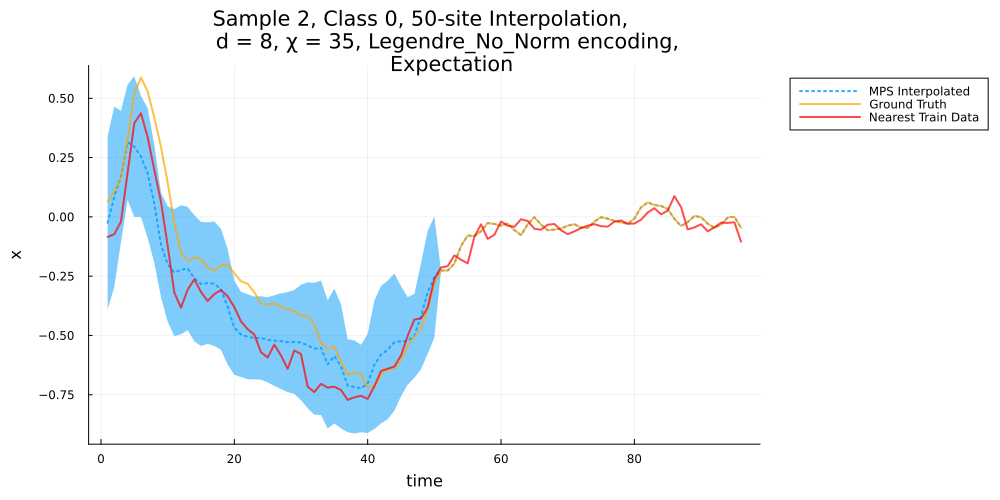

In [25]:


class = 0
impute_sites = collect(1:50)
instance_idx = 2
stats, mse_stats, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train, n_baselines=1);

plot(p1)

In [26]:
impute_sites = collect(2:50)

n1s = sum(y_test)
n0s = length(y_test) - n1s

n_each = 6


samples = [shuffle(1:n0s)[1:n_each]; shuffle(1:n1s)[1:n_each]]
classes = [zeros(Int,n_each); ones(Int,n_each)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end



╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.778664 │
│    MSE │ 0.0238897 │
│   MAPE │   1.14965 │
│    MAE │  0.121886 │
│   RMSE │ 0.0238897 │
╰────────┴───────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.889308 │
│    MSE │ 0.119619 │
│   MAPE │  2.57594 │
│    MAE │ 0.242468 │
│   RMSE │ 0.119619 │
╰────────┴──────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.14479 │
│    MSE │  0.13819 │
│   MAPE │   4.7116 │
│    MAE │ 0.320264 │
│   RMSE │  0.13819 │
╰────────┴──────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.876085 │
│    MSE │ 0.024972 │
│   MAPE │  1.97626 │
│    MAE │ 0.131191 │
│   RMSE │ 0.024972 │
╰────────┴──────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.404344 │
│    MSE │ 0.0234799 │
│   MAPE │  0.464128 │
│    MAE │  0.115713 │
│   RMSE │ 0.0234799 │
╰────────┴─────

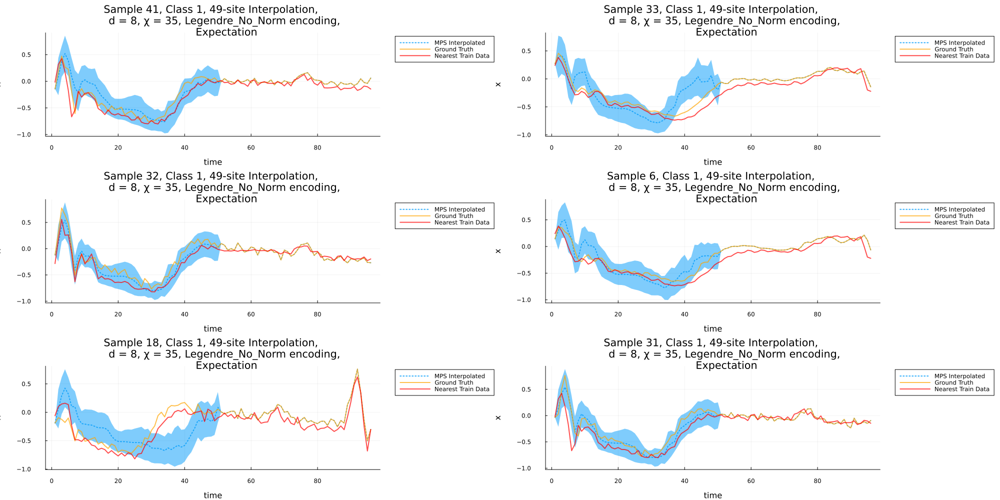

In [8]:

p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
# savefig(p1, "figs/c0ecg_ns.svg")

p2 = plot(ps[7:12]..., size=(2000,1000), layout=(3,2))
# savefig(p2, "figs/c1ecg_ns.svg")


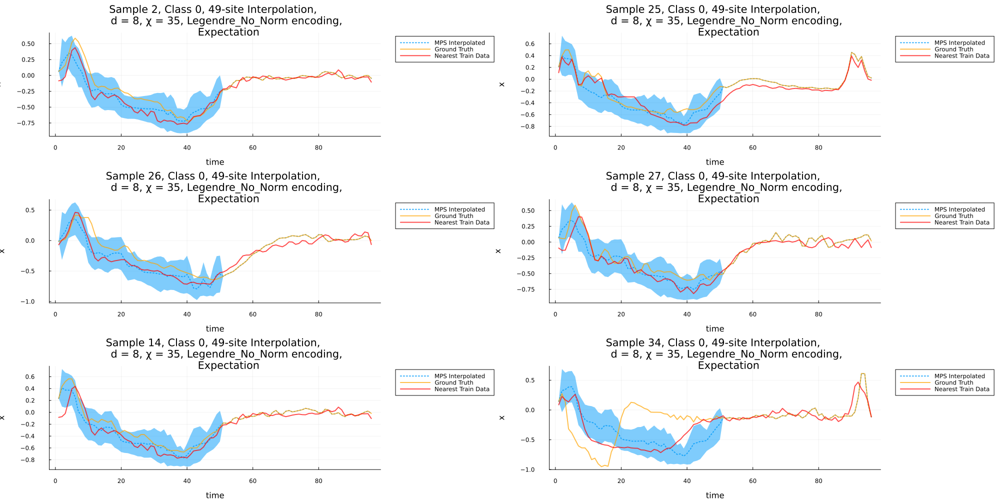

In [9]:
display(p1)

In [27]:
n1s = sum(y_test)
n0s = length(y_test) - n1s


samples = [shuffle(1:n0s); shuffle(1:n1s)]
classes = [zeros(Int,n0s); ones(Int,n1s)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end


╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  0.99862 │
│    MSE │  0.20102 │
│   MAPE │  1.52557 │
│    MAE │ 0.366935 │
│   RMSE │  0.20102 │
╰────────┴──────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.701251 │
│    MSE │ 0.0736518 │
│   MAPE │   1.22362 │
│    MAE │  0.243721 │
│   RMSE │ 0.0736518 │
╰────────┴───────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.35899 │
│    MSE │ 0.270678 │
│   MAPE │  4.72817 │
│    MAE │ 0.493406 │
│   RMSE │ 0.270678 │
╰────────┴──────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.05407 │
│    MSE │ 0.210579 │
│   MAPE │  4.93712 │
│    MAE │ 0.381864 │
│   RMSE │ 0.210579 │
╰────────┴──────────╯
╭────────┬────────────╮
│ Metric │      Value │
├────────┼────────────┤
│  SMAPE │   0.239024 │
│    MSE │ 0.00972706 │
│   MAPE │   0.272957 │
│    MAE │  0.0788719 │
│   RMSE │ 0.00972706 │
╰──────

In [28]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

@show describe(stats_df);
println()
@show describe(MSE_stats_df);

describe(stats_df) = 5×7 DataFrame
 Row │ variable  mean      min         median     max        nmissing  eltype
     │ Symbol    Float64   Float64     Float64    Float64    Int64     DataType
─────┼──────────────────────────────────────────────────────────────────────────
   1 │ MAE       0.152404  0.0470851   0.117364    0.498753         0  Float64
   2 │ MAPE      2.48967   0.272957    0.915653   21.0912           0  Float64
   3 │ MSE       0.047883  0.00374177  0.0210581   0.281749         0  Float64
   4 │ RMSE      0.047883  0.00374177  0.0210581   0.281749         0  Float64
   5 │ SMAPE     0.633512  0.183498    0.551447    1.41486          0  Float64

describe(MSE_stats_df) = 5×7 DataFrame
 Row │ variable  mean       min        median     max        nmissing  eltype
     │ Symbol    Float64    Float64    Float64    Float64    Int64     DataType
─────┼──────────────────────────────────────────────────────────────────────────
   1 │ MAE       0.164193   0.0817763  0.142434    0

# Give it less data

In [4]:
n1s = sum(y_test)
n0s = length(y_test) - n1s

n_each = 6
impute_sites = collect(5:96)


samples = [shuffle(1:n0s)[1:n_each]; shuffle(1:n1s)[1:n_each]]
classes = [zeros(Int,n_each); ones(Int,n_each)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.997124 │
│    MSE │ 0.148374 │
│   MAPE │   6.9914 │
│    MAE │ 0.282557 │
│   RMSE │ 0.148374 │
╰────────┴──────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │   1.1411 │
│    MSE │  0.13809 │
│   MAPE │  8.08875 │
│    MAE │ 0.275002 │
│   RMSE │  0.13809 │
╰────────┴──────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │     0.938 │
│    MSE │ 0.0306388 │
│   MAPE │   1.46821 │
│    MAE │  0.133211 │
│   RMSE │ 0.0306388 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.867151 │
│    MSE │ 0.0149453 │
│   MAPE │   1.51669 │
│    MAE │  0.104911 │
│   RMSE │ 0.0149453 │
╰────────┴───────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.11173 │
│    MSE │ 0.024064 │
│   MAPE │  5.10153 │
│    MAE │  0.12466 │
│   RMSE │ 0.024064 │
╰────────┴────

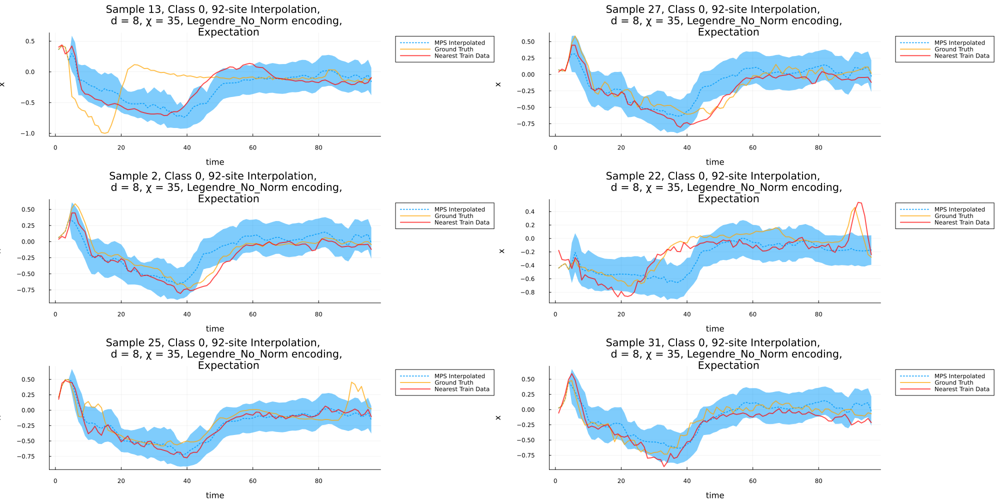

In [5]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/c0ecg_short_ns.svg")

p2 = plot(ps[7:12]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/c1ecg_short_ns.svg")

display(p1)

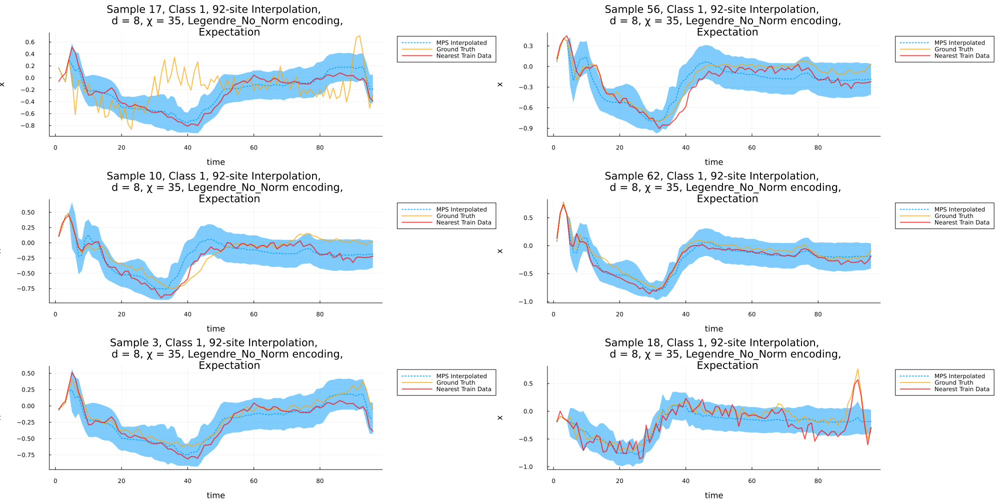

In [6]:
display(p2)

In [8]:
n1s = sum(y_test)
n0s = length(y_test) - n1s


samples = [shuffle(1:n0s); shuffle(1:n1s)]
classes = [zeros(Int,n0s); ones(Int,n1s)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   1.14111 │
│    MSE │ 0.0555703 │
│   MAPE │   3.58836 │
│    MAE │   0.17302 │
│   RMSE │ 0.0555703 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   1.08886 │
│    MSE │ 0.0247534 │
│   MAPE │   2.07501 │
│    MAE │  0.131742 │
│   RMSE │ 0.0247534 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.955437 │
│    MSE │ 0.0169116 │
│   MAPE │   2.48027 │
│    MAE │  0.105518 │
│   RMSE │ 0.0169116 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.996229 │
│    MSE │ 0.0160229 │
│   MAPE │   5.42674 │
│    MAE │  0.110413 │
│   RMSE │ 0.0160229 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   1.06511 │
│    MSE │ 0.0829418 │
│   MAPE │   6.07051 │
│    MAE │  0.200039 │
│   RMSE │ 

In [9]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.136159,0.063777,0.111383,0.284459,0,Float64
2,MAPE,7.62503,0.822994,3.48691,108.87,0,Float64
3,MSE,0.0367088,0.0054951,0.0188371,0.148374,0,Float64
4,RMSE,0.0367088,0.0054951,0.0188371,0.148374,0,Float64
5,SMAPE,0.919083,0.501948,0.896473,1.35405,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.127551,0.0780763,0.107975,0.331852,0,Float64
2,MAPE,4.88759,1.05717,2.99361,57.8,0,Float64
3,MSE,0.0317701,0.00695549,0.0164133,0.185536,0,Float64
4,RMSE,0.0317701,0.00695549,0.0164133,0.185536,0,Float64
5,SMAPE,0.892303,0.571263,0.852193,1.37692,0,Float64


# Middle Only

In [12]:
n1s = sum(y_test)
n0s = length(y_test) - n1s

n_each = 6


samples = [shuffle(1:n0s)[1:n_each]; shuffle(1:n1s)[1:n_each]]
classes = [zeros(Int,n_each); ones(Int,n_each)]
impute_sites = [1:40; 60:96]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │     1.169 │
│    MSE │ 0.0254561 │
│   MAPE │   12.1246 │
│    MAE │  0.133676 │
│   RMSE │ 0.0254561 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.975852 │
│    MSE │ 0.0205026 │
│   MAPE │   6.52797 │
│    MAE │  0.115625 │
│   RMSE │ 0.0205026 │
╰────────┴───────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.24524 │
│    MSE │ 0.100107 │
│   MAPE │  3.50187 │
│    MAE │ 0.254078 │
│   RMSE │ 0.100107 │
╰────────┴──────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   1.16967 │
│    MSE │ 0.0951897 │
│   MAPE │   3.16422 │
│    MAE │  0.236255 │
│   RMSE │ 0.0951897 │
╰────────┴───────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.05531 │
│    MSE │ 0.148104 │
│   MAPE │  3.75444 │
│    MAE │ 0.285889 │
│   RMSE │ 0.148104 │
╰────

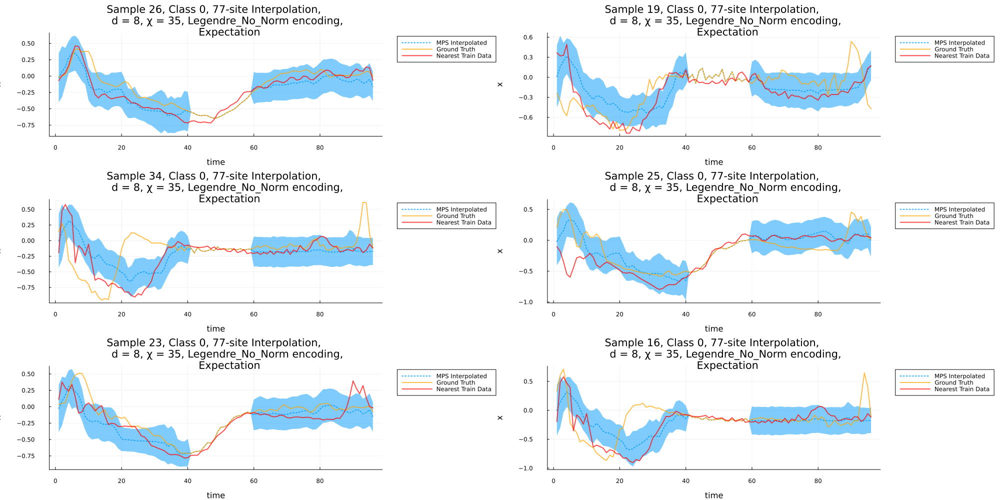

In [13]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/c0ecg_short_mid_ns.svg")

p2 = plot(ps[7:12]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/c1ecg_short_mid_ns.svg")

display(p1)

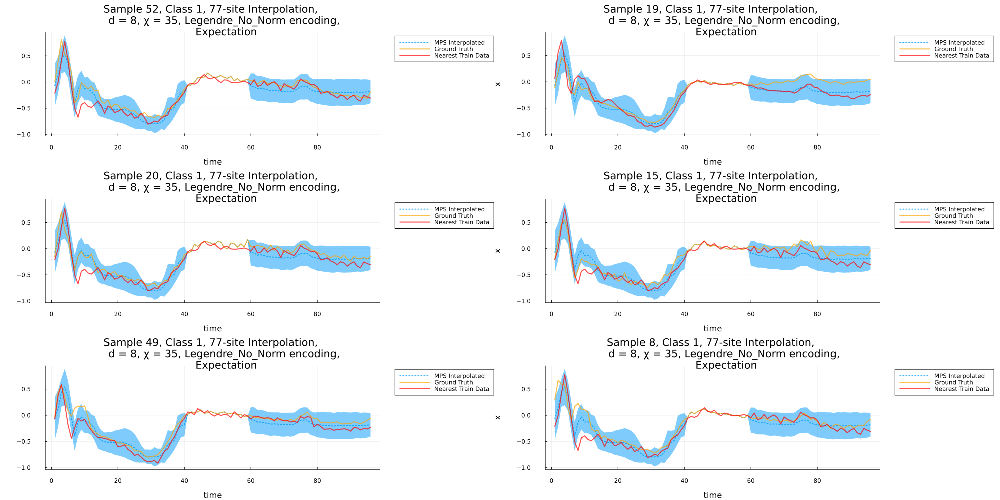

In [14]:
display(p2)

In [15]:
n1s = sum(y_test)
n0s = length(y_test) - n1s


samples = [shuffle(1:n0s); shuffle(1:n1s)]
classes = [zeros(Int,n0s); ones(Int,n1s)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.593997 │
│    MSE │ 0.030606 │
│   MAPE │  1.74928 │
│    MAE │  0.12898 │
│   RMSE │ 0.030606 │
╰────────┴──────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.557438 │
│    MSE │ 0.0285684 │
│   MAPE │   2.20275 │
│    MAE │  0.114248 │
│   RMSE │ 0.0285684 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   1.10832 │
│    MSE │ 0.0298799 │
│   MAPE │   2.71757 │
│    MAE │  0.133595 │
│   RMSE │ 0.0298799 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   1.20963 │
│    MSE │ 0.0347959 │
│   MAPE │   1.97202 │
│    MAE │  0.146825 │
│   RMSE │ 0.0347959 │
╰────────┴───────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │   1.1509 │
│    MSE │ 0.148877 │
│   MAPE │  4.10718 │
│    MAE │ 0.294302 │
│   RMSE │ 0.148877 │
╰────

In [16]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.132861,0.0672353,0.116243,0.294302,0,Float64
2,MAPE,5.64031,0.43646,2.74544,101.506,0,Float64
3,MSE,0.034951,0.00646609,0.0208516,0.150905,0,Float64
4,RMSE,0.034951,0.00646609,0.0208516,0.150905,0,Float64
5,SMAPE,0.796036,0.425471,0.800509,1.24524,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.147147,0.0824577,0.122895,0.33405,0,Float64
2,MAPE,4.47847,0.435908,2.30134,70.8605,0,Float64
3,MSE,0.0460706,0.0104303,0.0264249,0.230913,0,Float64
4,RMSE,0.0460706,0.0104303,0.0264249,0.230913,0,Float64
5,SMAPE,0.808374,0.429024,0.760248,1.22525,0,Float64


# IPD

In [2]:
svpath = "../../Data/italypower/mps_saves/legendreNN2_ns_d12_chi60.jld2"
f = jldopen(svpath, "r")
    X_train_scaled = read(f, "X_train_scaled")
    y_train = read(f, "y_train")
    X_test_scaled = read(f, "X_test_scaled")
    y_test = read(f, "y_test");
    mps = read(f, "mps")
    opts = read(f, "opts")
close(f)

fc = init_imputation_problem(mps, X_train_scaled, y_train, X_test_scaled, y_test, opts);

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
                         Summary:

 - Dataset has 67 training samples and 1029 testing samples.
 - 2 class(es) was detected. Slicing MPS into individual states...
 - Time independent encoding - Legendre_No_Norm - detected.
 - d = 12, chi_max = 60

 Created 2 forecastable struct(s) containing class-wise mps and test samples.


╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.737535 │
│    MSE │ 0.0215316 │
│   MAPE │   2.80559 │
│    MAE │  0.111227 │
│   RMSE │ 0.0215316 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.949353 │
│    MSE │ 0.0381023 │
│   MAPE │   2.44882 │
│    MAE │  0.144854 │
│   RMSE │ 0.0381023 │
╰────────┴───────────╯


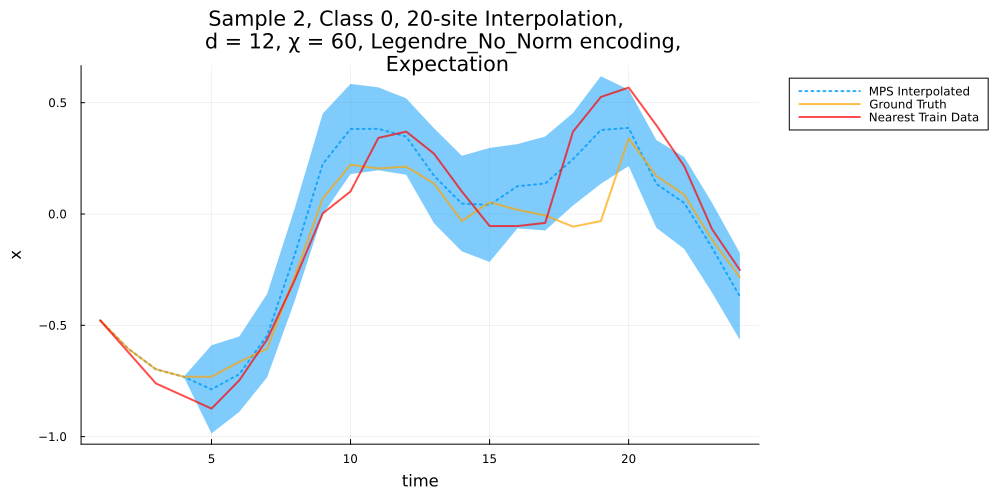

In [4]:
class = 0
impute_sites = collect(5:24)
instance_idx = 2
stats, mse_stats, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);

plot(p1)

In [5]:
n1s = sum(y_test)
n0s = length(y_test) - n1s
impute_sites = collect(5:24)


n_each = 6


samples = [shuffle(1:n0s)[1:n_each]; shuffle(1:n1s)[1:n_each]]
classes = [zeros(Int,n_each); ones(Int,n_each)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end



╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.652533 │
│    MSE │ 0.0239281 │
│   MAPE │   17.9982 │
│    MAE │  0.100623 │
│   RMSE │ 0.0239281 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.967299 │
│    MSE │ 0.0471184 │
│   MAPE │    9.4754 │
│    MAE │  0.156351 │
│   RMSE │ 0.0471184 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.869531 │
│    MSE │ 0.0312315 │
│   MAPE │   43.2437 │
│    MAE │  0.143436 │
│   RMSE │ 0.0312315 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.980598 │
│    MSE │ 0.0412481 │
│   MAPE │   54.4609 │
│    MAE │  0.168332 │
│   RMSE │ 0.0412481 │
╰────────┴───────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.894202 │
│    MSE │ 0.106815 │
│   MAPE │  1.38296 │
│    MAE │ 0.262087 │
│   RMSE │ 0.10681

In [6]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/c0IPD_ns.svg")

p2 = plot(ps[7:12]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/c1IPD_ns.svg")

"/home/noodles/Documents/QuantumInspiredML/QuantumInspiredML/Imputation/impute_benchmarks/figs/c1IPD_ns.svg"

p1 = Plot{Plots.GRBackend() n=18}


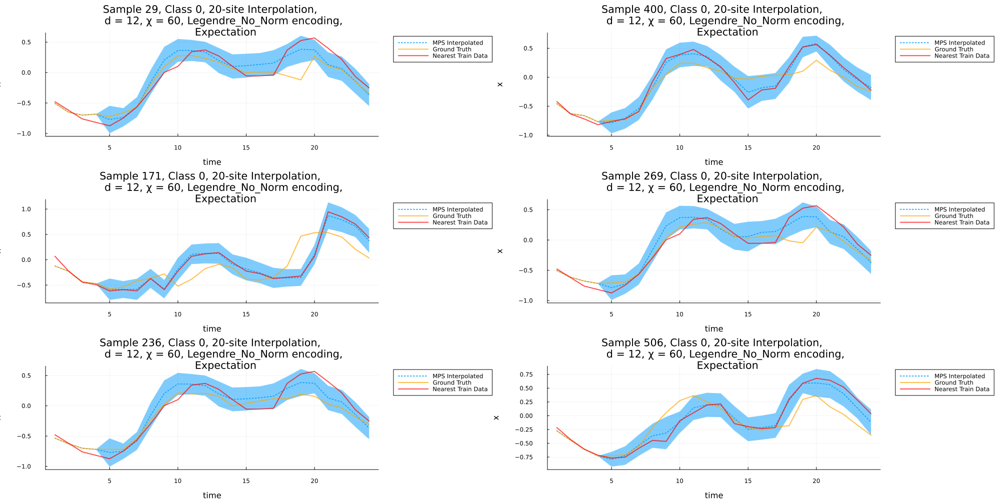

In [7]:
@show p1

In [11]:
n1s = sum(y_test)
n0s = length(y_test) - n1s


samples = [shuffle(1:n0s); shuffle(1:n1s)]
classes = [zeros(Int,n0s); ones(Int,n1s)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end


In [12]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.139497,0.0859541,0.121939,0.390242,0,Float64
2,MAPE,6.19476,0.315461,1.9102,552.912,0,Float64
3,MSE,0.0350744,0.00954569,0.0222542,0.285504,0,Float64
4,RMSE,0.0350744,0.00954569,0.0222542,0.285504,0,Float64
5,SMAPE,0.767675,0.288617,0.751565,1.5354,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.158875,0.0929192,0.150901,0.407264,0,Float64
2,MAPE,6.94413,0.443837,2.15047,948.404,0,Float64
3,MSE,0.0427341,0.0162867,0.0346712,0.305899,0,Float64
4,RMSE,0.0427341,0.0162867,0.0346712,0.305899,0,Float64
5,SMAPE,0.828585,0.368076,0.846856,1.252,0,Float64


In [10]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.139497,0.0859541,0.121939,0.390242,0,Float64
2,MAPE,6.19476,0.315461,1.9102,552.912,0,Float64
3,MSE,0.0350744,0.00954569,0.0222542,0.285504,0,Float64
4,RMSE,0.0350744,0.00954569,0.0222542,0.285504,0,Float64
5,SMAPE,0.767675,0.288617,0.751565,1.5354,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.158875,0.0929192,0.150901,0.407264,0,Float64
2,MAPE,6.94413,0.443837,2.15047,948.404,0,Float64
3,MSE,0.0427341,0.0162867,0.0346712,0.305899,0,Float64
4,RMSE,0.0427341,0.0162867,0.0346712,0.305899,0,Float64
5,SMAPE,0.828585,0.368076,0.846856,1.252,0,Float64


# Kepler 125

In [1]:
svpath = "../../Data/NASA_kepler/mps_saves/legendreNN2_ns_d12_chi35.jld2"
f = jldopen(svpath, "r")
    X_train_scaled = read(f, "X_train_scaled")
    y_train = read(f, "y_train")
    X_test_scaled = read(f, "X_test_scaled")
    y_test = read(f, "y_test");
    mps = read(f, "mps")
    #opts = read(f, "opts")
close(f)
Rdtype = Float64

verbosity = 0
test_run = false
track_cost = false
#
encoding = legendre(norm=false)
encode_classes_separately = false
train_classes_separately = false

#encoding = Basis("Legendre")
dtype = encoding.iscomplex ? ComplexF64 : Float64
opts=Options(; nsweeps=20, chi_max=35,  update_iters=1, verbosity=1, dtype=dtype, loss_grad=loss_grad_KLD,
bbopt=BBOpt("CustomGD"), track_cost=false, eta=0.0025, rescale = (false, true), d=12, aux_basis_dim=2, encoding=encoding, 
encode_classes_separately=encode_classes_separately, train_classes_separately=train_classes_separately, exit_early=false, sigmoid_transform=false)


fc = init_imputation_problem(mps, X_train_scaled, y_train, X_test_scaled, y_test, opts);

UndefVarError: UndefVarError: `jldopen` not defined

╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.02797 │
│    MSE │ 0.319579 │
│   MAPE │  1.51398 │
│    MAE │  0.47237 │
│   RMSE │ 0.319579 │
╰────────┴──────────╯


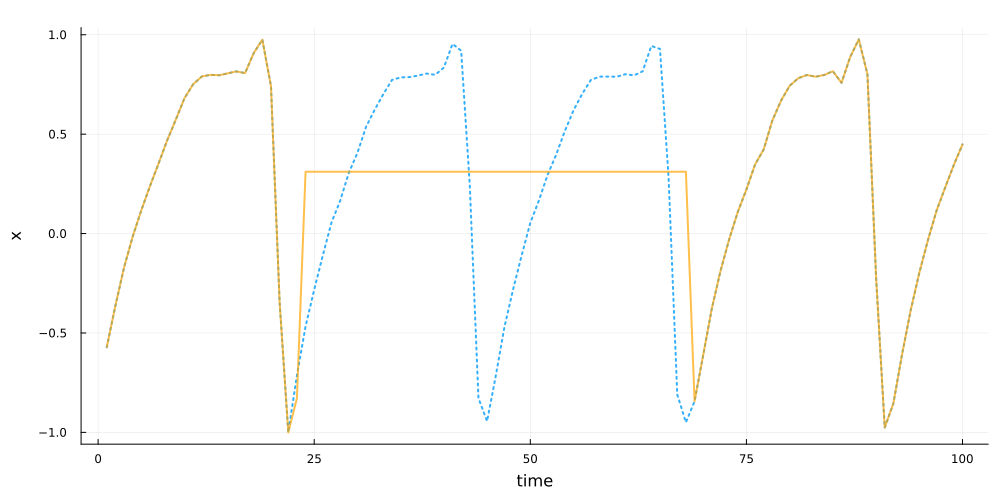

In [37]:
class = 0
impute_sites = collect(23:68)
instance_idx = 11
stats, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMode; MSE_baseline=false, X_train_scaled=X_train_scaled, y_train=y_train);

plot(p1; legend=:none)

In [44]:
xs = p1[1][1][:x];
mps_fit = p1[1][1][:y];
ground_truth = p1[1][2][:y];

In [45]:
savefig(p1, "figs/KeplerExemplar.svg")
npzwrite("figs/KeplarExemplar.npz", Dict("xs" => xs, "mps_fit" => mps_fit, "ground_truth" =>ground_truth))


╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.960824 │
│    MSE │ 0.265711 │
│   MAPE │  1.34492 │
│    MAE │ 0.423367 │
│   RMSE │ 0.265711 │
╰────────┴──────────╯


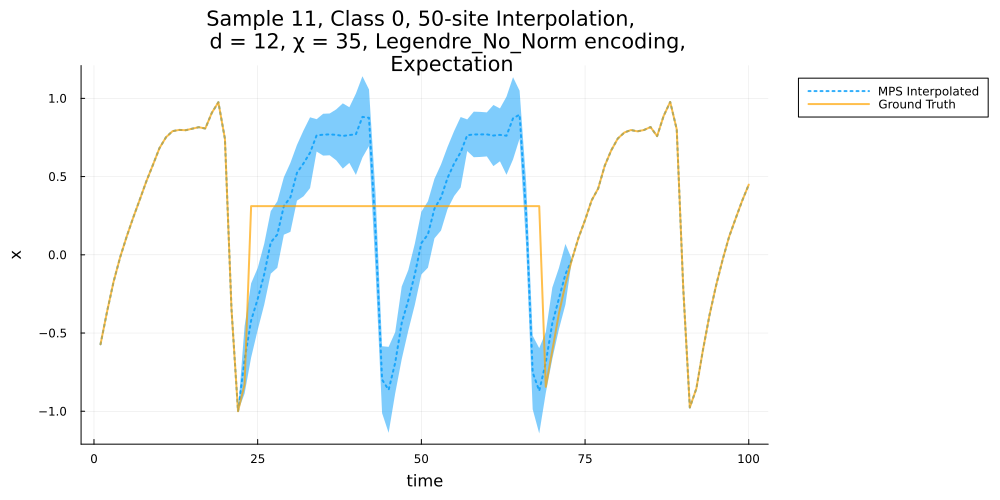

In [41]:
class = 0
impute_sites = collect(23:72)
instance_idx = 11
stats, p2 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=false, X_train_scaled=X_train_scaled, y_train=y_train);

plot(p2)

In [42]:
xs = p2[1][1][:x];
mps_fit = p2[1][1][:y];
ground_truth = p2[1][2][:y];

savefig(p2, "figs/KeplerExemplar_mean.svg")
npzwrite("figs/KeplarExemplar_mean.npz", Dict("xs" => xs, "mps_fit" => mps_fit, "ground_truth" =>ground_truth))

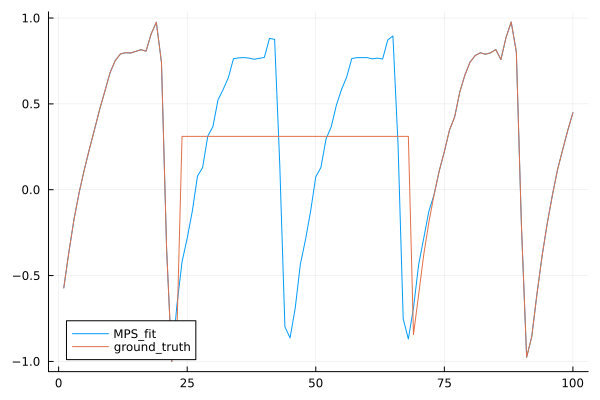

In [43]:
plot(xs, mps_fit; label="MPS_fit")
plot!(xs, ground_truth; label="ground_truth")

In [4]:
ns = length(y_test) 
impute_sites = collect(25:75)


samples = 1:ns
classes = zeros(Int,ns)

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.445338 │
│    MSE │  0.10408 │
│   MAPE │ 0.890635 │
│    MAE │ 0.175614 │
│   RMSE │  0.10408 │
╰────────┴──────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.300083 │
│    MSE │ 0.0256509 │
│   MAPE │   0.40427 │
│    MAE │ 0.0948439 │
│   RMSE │ 0.0256509 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   0.29862 │
│    MSE │ 0.0320329 │
│   MAPE │  0.365189 │
│    MAE │  0.112862 │
│   RMSE │ 0.0320329 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.287344 │
│    MSE │ 0.0241948 │
│   MAPE │  0.335163 │
│    MAE │ 0.0936488 │
│   RMSE │ 0.0241948 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.322062 │
│    MSE │ 0.0318086 │
│   MAPE │  0.324846 │
│    MAE │  0.105652 │
│   RMSE │ 0.0318086

In [5]:
stats_df = vcat(DataFrame.(stats[1:7])...)
MSE_stats_df = vcat(DataFrame.(MSE_stats[1:7])...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.127179,0.0906435,0.112862,0.179287,0,Float64
2,MAPE,0.660133,0.324846,0.558623,1.1,0,Float64
3,MSE,0.0467388,0.0232239,0.0320329,0.10408,0,Float64
4,RMSE,0.0467388,0.0232239,0.0320329,0.10408,0,Float64
5,SMAPE,0.360315,0.269427,0.33776,0.490055,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.0892038,0.0673877,0.0936488,0.0991786,0,Float64
2,MAPE,0.40109,0.322929,0.40427,0.532711,0,Float64
3,MSE,0.0246816,0.0236266,0.0243384,0.0256509,0,Float64
4,RMSE,0.0246816,0.0236266,0.0243384,0.0256509,0,Float64
5,SMAPE,0.289225,0.2103,0.287344,0.354019,0,Float64


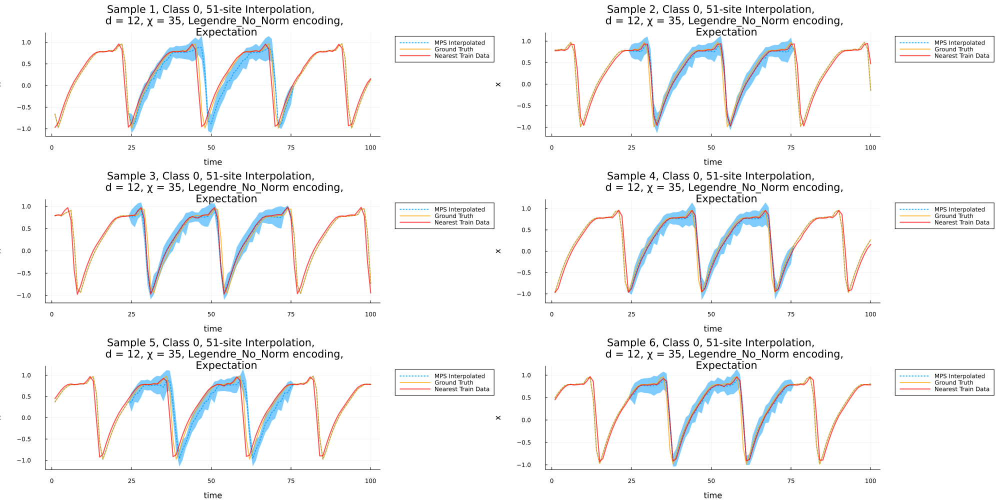

In [30]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/Keps125_1_ns.svg")

p2 = plot(ps[7:11]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/Keps125_2_ns.svg")
display(p1)

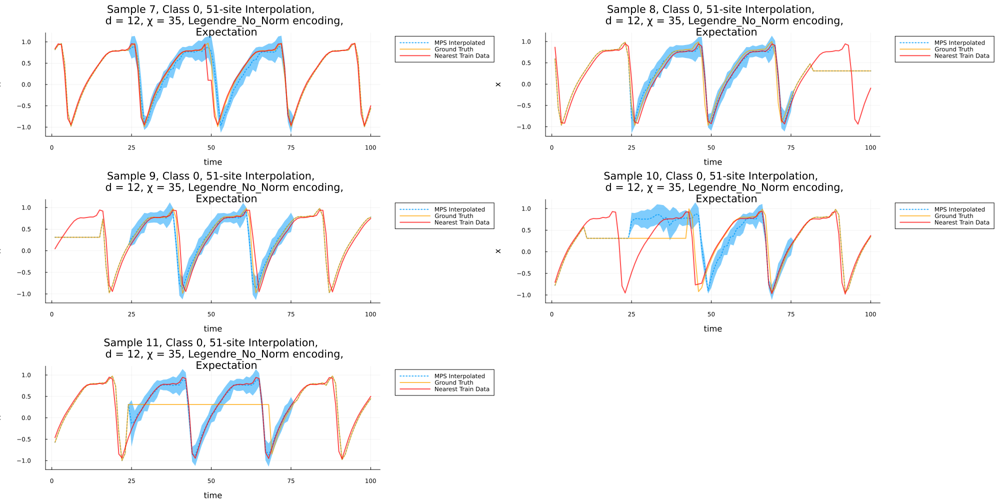

In [31]:
display(p2)

## Direct Mode

In [8]:
ns = length(y_test) 


samples = 1:ns
classes = zeros(Int,ns)

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMode; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.314438 │
│    MSE │ 0.0321473 │
│   MAPE │  0.465152 │
│    MAE │  0.102584 │
│   RMSE │ 0.0321473 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.300083 │
│    MSE │ 0.0256509 │
│   MAPE │   0.40427 │
│    MAE │ 0.0948439 │
│   RMSE │ 0.0256509 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.280936 │
│    MSE │ 0.0245649 │
│   MAPE │  0.336744 │
│    MAE │ 0.0927808 │
│   RMSE │ 0.0245649 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.287344 │
│    MSE │ 0.0241948 │
│   MAPE │  0.335163 │
│    MAE │ 0.0936488 │
│   RMSE │ 0.0241948 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.322195 │
│    MSE │ 0.0262294 │
│   MAPE │  0.331425 │
│    MAE │  0.104261 │
│   RMSE │ 

In [9]:
stats_df = vcat(DataFrame.(stats[1:7])...)
MSE_stats_df = vcat(DataFrame.(MSE_stats[1:7])...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.0905553,0.0689081,0.0927808,0.104261,0,Float64
2,MAPE,0.440945,0.331425,0.444602,0.601484,0,Float64
3,MSE,0.0258218,0.0234652,0.0247929,0.0321473,0,Float64
4,RMSE,0.0258218,0.0234652,0.0247929,0.0321473,0,Float64
5,SMAPE,0.291133,0.211455,0.303634,0.344536,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.0892038,0.0673877,0.0936488,0.0991786,0,Float64
2,MAPE,0.40109,0.322929,0.40427,0.532711,0,Float64
3,MSE,0.0246816,0.0236266,0.0243384,0.0256509,0,Float64
4,RMSE,0.0246816,0.0236266,0.0243384,0.0256509,0,Float64
5,SMAPE,0.289225,0.2103,0.287344,0.354019,0,Float64


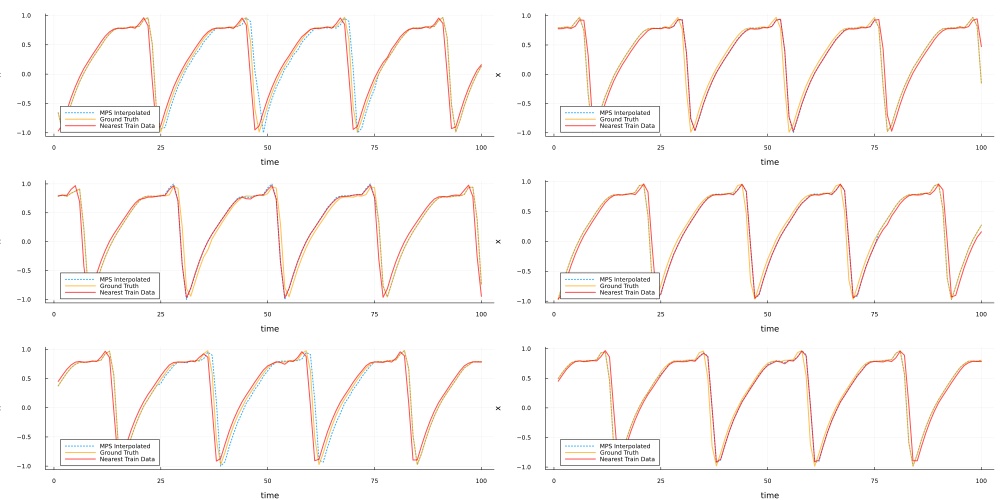

In [35]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/Keps125_1_mode_ns.svg")

p2 = plot(ps[7:11]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/Keps125_2_mode_ns.svg")
display(p1)

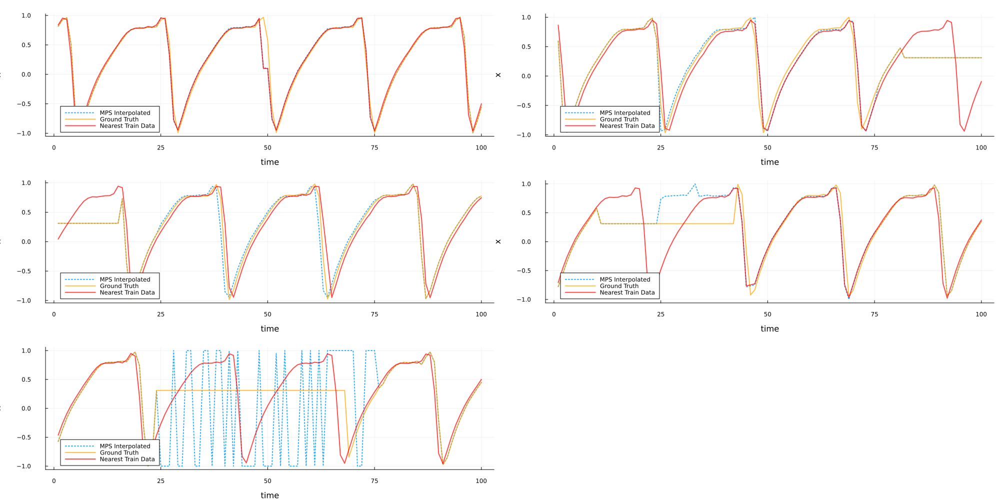

In [37]:
display(p2)

In [13]:
class = 0
impute_sites = collect(23:75)
instance_idx = 11
stats, mse_stats, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMode; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);

plot(p1)
savefig(p1, "figs/Keps125_2_mode_ns_inst11.svg")


╭────────┬─────────╮
│ Metric │   Value │
├────────┼─────────┤
│  SMAPE │ 1.57128 │
│    MSE │ 1.17992 │
│   MAPE │ 3.97232 │
│    MAE │  1.0349 │
│   RMSE │ 1.17992 │
╰────────┴─────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.960288 │
│    MSE │  0.27263 │
│   MAPE │   1.3811 │
│    MAE │ 0.416247 │
│   RMSE │  0.27263 │
╰────────┴──────────╯


"/home/noodles/Documents/QuantumInspiredML/QuantumInspiredML/Imputation/impute_benchmarks/figs/Keps125_2_mode_ns_inst11_bad.svg"

# Rand Kepler

In [3]:
svpath = "../../Data/NASA_kepler/mps_saves/legendreNN2_d12_chi35.jld2"
f = jldopen(svpath, "r")
    X_train_scaled = read(f, "X_train_scaled")
    y_train = read(f, "y_train")
    X_test_scaled = read(f, "X_test_scaled")
    y_test = read(f, "y_test");
    mps = read(f, "mps")
    opts = read(f, "opts")
close(f)

fc = init_imputation_problem(mps, X_train_scaled, y_train, X_test_scaled, y_test, opts);

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
                         Summary:

 - Dataset has 36 training samples and 11 testing samples.
 - 1 class(es) was detected. Slicing MPS into individual states...
 - Time independent encoding - Legendre_No_Norm - detected.
 - d = 12, chi_max = 35

 Created 1 forecastable struct(s) containing class-wise mps and test samples.


In [20]:
ns = length(y_test) 
impute_sites = shuffle(1:100)[1:90]


samples = 1:ns
classes = zeros(Int,ns)

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.19243 │
│    MSE │  0.63882 │
│   MAPE │  1.85313 │
│    MAE │ 0.618313 │
│   RMSE │  0.63882 │
╰────────┴──────────╯
╭────────┬────────────╮
│ Metric │      Value │
├────────┼────────────┤
│  SMAPE │     0.1205 │
│    MSE │ 0.00395745 │
│   MAPE │    0.12078 │
│    MAE │  0.0402488 │
│   RMSE │ 0.00395745 │
╰────────┴────────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.20328 │
│    MSE │ 0.744004 │
│   MAPE │  7.87114 │
│    MAE │ 0.659282 │
│   RMSE │ 0.744004 │
╰────────┴──────────╯
╭────────┬────────────╮
│ Metric │      Value │
├────────┼────────────┤
│  SMAPE │   0.230541 │
│    MSE │ 0.00621347 │
│   MAPE │   0.626005 │
│    MAE │  0.0642983 │
│   RMSE │ 0.00621347 │
╰────────┴────────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.30072 │
│    MSE │ 0.776573 │
│   MAPE │  3.27664 │
│    MAE │ 0.698148 │
│   RMSE │ 0.77657

In [21]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.637831,0.557838,0.637594,0.698148,0,Float64
2,MAPE,2.97087,1.69164,2.49354,7.87114,0,Float64
3,MSE,0.667172,0.514554,0.658653,0.776573,0,Float64
4,RMSE,0.667172,0.514554,0.658653,0.776573,0,Float64
5,SMAPE,1.23802,1.10605,1.25857,1.38537,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.161085,0.0402488,0.121252,0.401127,0,Float64
2,MAPE,1.00633,0.12078,0.626005,2.70886,0,Float64
3,MSE,0.0816689,0.00395745,0.0362583,0.273417,0,Float64
4,RMSE,0.0816689,0.00395745,0.0362583,0.273417,0,Float64
5,SMAPE,0.458005,0.1205,0.36444,1.06668,0,Float64


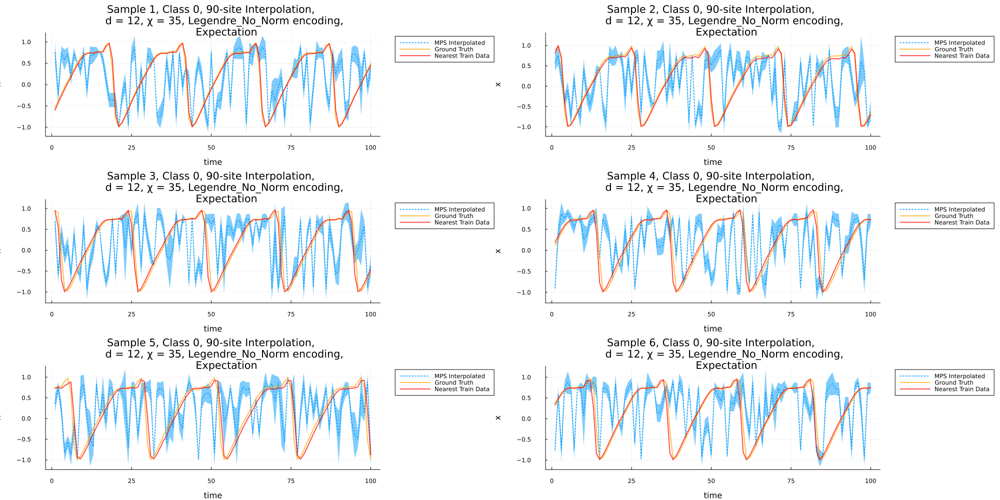

In [22]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/Keps125_1_rand.svg")

p2 = plot(ps[7:11]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/Keps125_2_rand.svg")
display(p1)

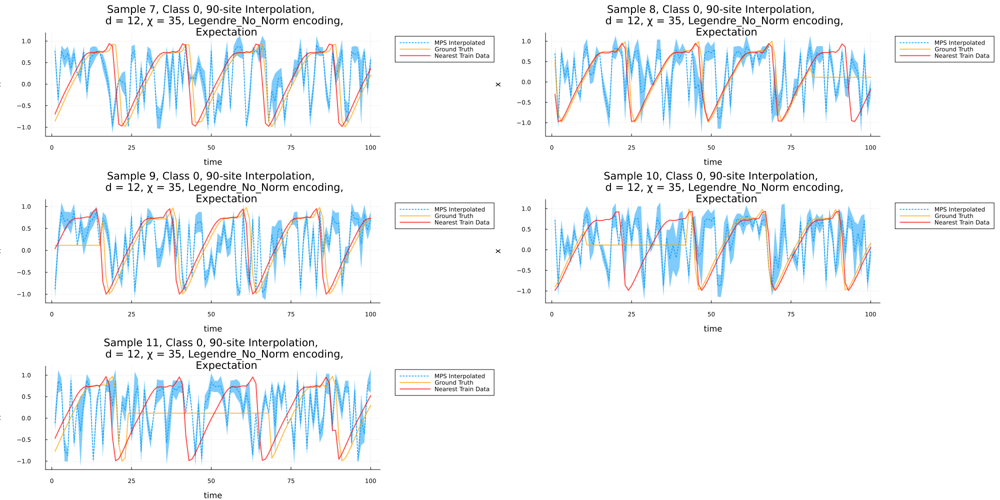

In [23]:
display(p2)

# Kepler 564

In [53]:

f = jldopen("../../Data/NASA_kepler/mps_saves/legendreNN_s564_d12_chi34.jld2")
X_train_scaled = read(f, "X_train_scaled")
y_train = read(f, "y_train")
X_test_scaled = read(f, "X_test_scaled")
y_test = read(f, "y_test");
mps = read(f, "mps")
opts = read(f, "opts")
close(f)

fc = init_imputation_problem(mps, X_train_scaled, y_train, X_test_scaled, y_test, opts);

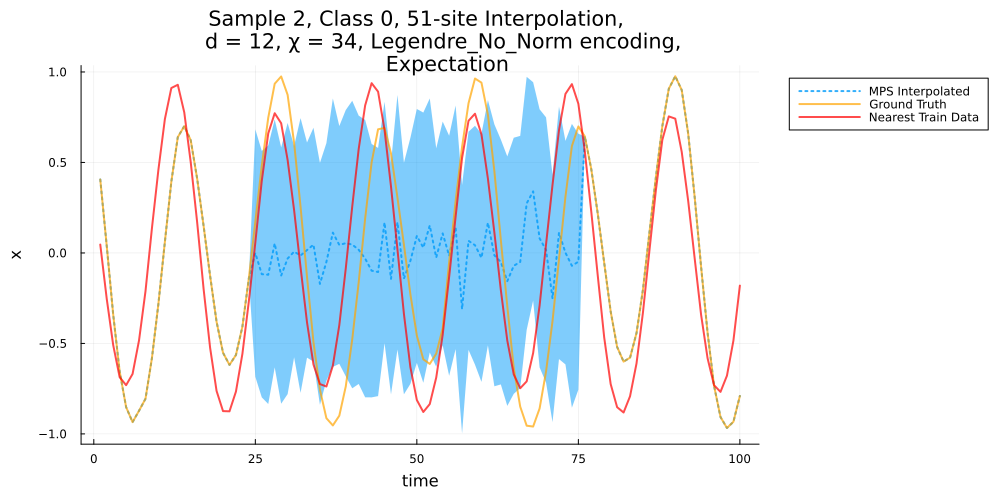

In [54]:
class = 0
impute_sites = collect(25:75)
instance_idx = 2
stats, mse_stats, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);

plot(p1)

In [55]:
ns = length(y_test) 


samples = 1:ns
classes = zeros(Int,ns)

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_impute_single_time_series(fc, class, instance_idx, impute_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

In [56]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.217501,0.0574605,0.113854,0.586258,0,Float64
2,MAPE,7.03645,0.288472,1.09401,106.671,0,Float64
3,MSE,0.103051,0.00494075,0.0174776,0.448161,0,Float64
4,RMSE,0.103051,0.00494075,0.0174776,0.448161,0,Float64
5,SMAPE,0.69571,0.222376,0.394725,1.80708,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.171684,0.0462833,0.13347,0.517761,0,Float64
2,MAPE,8.60129,0.283754,0.945156,129.724,0,Float64
3,MSE,0.0585071,0.00342999,0.0226979,0.364049,0,Float64
4,RMSE,0.0585071,0.00342999,0.0226979,0.364049,0,Float64
5,SMAPE,0.542485,0.186248,0.471602,1.77636,0,Float64


In [57]:
stats_df_tr = vcat(DataFrame.(stats[1:22])...)
MSE_stats_df_tr = vcat(DataFrame.(MSE_stats[1:22])...)

display(describe(stats_df_tr));
println()
display(describe(MSE_stats_df_tr));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.214246,0.0603681,0.113854,0.586258,0,Float64
2,MAPE,1.17775,0.288472,1.09401,3.93098,0,Float64
3,MSE,0.0997244,0.00494075,0.0174776,0.448161,0,Float64
4,RMSE,0.0997244,0.00494075,0.0174776,0.448161,0,Float64
5,SMAPE,0.663585,0.222376,0.394725,1.77815,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.152761,0.0462833,0.12581,0.302063,0,Float64
2,MAPE,1.55125,0.283754,0.945156,12.5557,0,Float64
3,MSE,0.0400591,0.00342999,0.0208365,0.135092,0,Float64
4,RMSE,0.0400591,0.00342999,0.0208365,0.135092,0,Float64
5,SMAPE,0.474702,0.186248,0.432491,0.75644,0,Float64


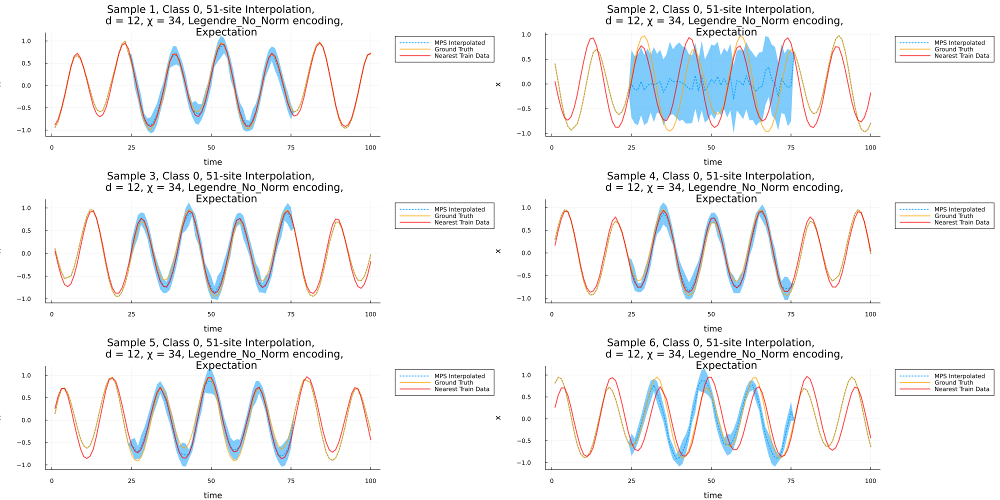

In [58]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/Keps564_1.svg")

p2 = plot(ps[end-5:end]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/Keps564_2.svg")
display(p1)

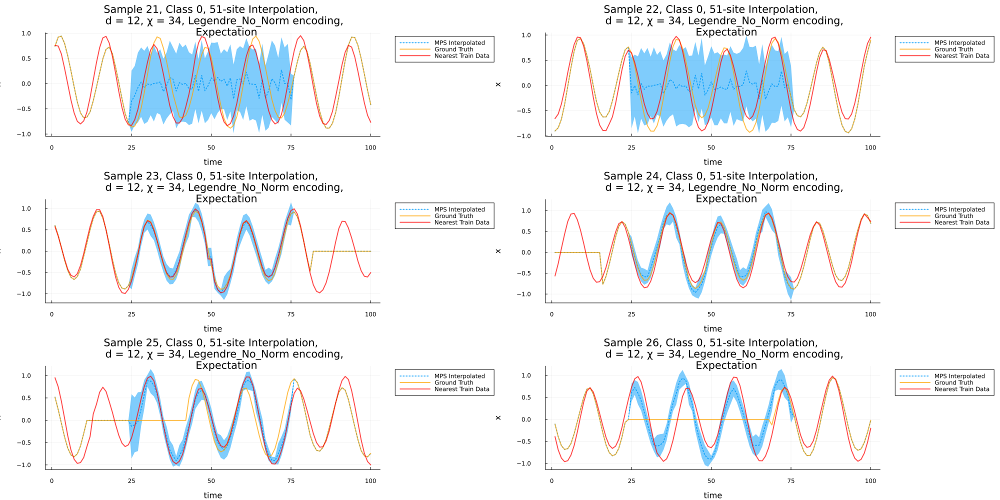

In [59]:
display(p2)